# A) Movimiento de un Cometa

Existen muchos cometas que orbitan alrededor del Sol con trayectorias elípticas. De acuerdo con las leyes de Kepler, cuando el cometa se encuentra lejos del centro de fuerza, su movimiento es lento, minetras que al acercarse al sol su velocidad es bastante grande. Este es un sistema físico que claramente debería ser solucionado con un método de paso adaptativo: en la región lejana se pueden utilizar pasos grandes mientras que en la región cercana se necesitan pasos muy cortos para tener un error pequeño-.

Utilizando coordenadas cartesianas en el plano de movimiento, la dinámica del cometa bajo la influencia Solar está descrito por las ecuaciones

\begin{align}
    \frac{d^2x}{dt^2} &= -GM \frac{x}{r^3}; & \frac{d^2y}{dt^2} = -GM \frac{y}{r^3}
\end{align}

donde $r = \sqrt{x^2 + y^2}$, G es la constante gravitacional de Newton y M es la masa del Sol.

## 1. 
Defininimos las constantes del sistema en unidades de masas solares, años y unidades astronómicas. En estas unidades las leyes de Kepler nos muestran que la constante de Cavendish toma el valor teórico

\begin{equation}
    G = 4\pi^2\;.
\end{equation}

In [4]:
using Plots
using LaTeXStrings
using Printf
using BenchmarkTools

const G = 4*pi^2 #au^3*Solar_masses^-1*yr^-2
const M = 1.0 #Solar masses

1.0

Luego, reescribimos las dos ecuaciones diferenciales de tal manera que se obtenga un sistema de cuatro ecuaciones diferenciales acopladas de orden uno, como sigue

\begin{align}
    \frac{dx}{dt} &= v_x; & \frac{dy}{dt} &= v_y;\\
    \frac{dv_x}{dt} &= -GM\frac{x}{r^3}; & \frac{dv_y}{dt} &= -GM\frac{y}{r^3}
\end{align}

Así, definimos una función que incluya el lado derecho de estas ecuaciones diferenciales

In [5]:
function Comet_EDO(t0, q0)
    #=
    dx/dt = f[1]
    dy/dt = f[2]
    dvx/dt = f[3]
    dvy/dt = f[4]
    =#
    x = q0[1]
    y = q0[2]
    vx = q0[3]
    vy = q0[4]
    f = zeros(4)
    f[1] = vx
    f[2] = vy
    f[3] = -G*M*x/sqrt(x^2+y^2)^3
    f[4] = -G*M*y/sqrt(x^2+y^2)^3
    return f
end

Comet_EDO (generic function with 1 method)

Luego, teniendo en cuenta que el alogoritmo Runge-Kutta de orden 4 es[1]

\begin{align}
k_1 &=\Delta x f(x_n,y_n)\,\,,\\
k_2 &=\Delta x f(x_n + \frac{\Delta x}{2},y_n + \frac{1}{2}k_1)\,\,,\nonumber\\
k_3 &=\Delta x f(x_n + \frac{\Delta x}{2},y_n + \frac{1}{2}k_2)\,\,,\nonumber\\
k_4 &=\Delta x f(x_n+\Delta x,y_n + k_3)\,\,,\nonumber\\
y_{n+1} &= y_n + \frac{1}{6}(k_1 + 2 k_2 + 2 k_3 + k_4) + \mathcal{O}(\Delta x^5)\,\,,
\end{align}

definimos una función para desarrollar este algoritmo

In [6]:
function RungeKutta4(q0, t0, tf, n, f)
    """
    q0: x, y, vx, vy initial conditions
    t0: initial time
    tf: final time
    n: number of steps
    f: right hand side of the differential equation
    """
    t = LinRange(t0,tf,n) #Derivation variable interval 
    q = zeros(length(q0),n) #array for storing the integrated variables
    q[:,1] .= q0 #initial conditions
    for i in 2:n
        dt = t[i] - t[i-1] #Derivation variable step size
        k1 = dt*f(t[i-1], q[:,i-1])
        k2 = dt*f(t[i-1] + dt/2, q[:,i-1] +k1[:]/2)
        k3 = dt*f(t[i-1] + dt/2, q[:,i-1] +k2[:]/2)
        k4 = dt*f(t[i-1] + dt, q[:,i-1] +k3[:])
        q[:,i] = q[:,i-1] + (k1 + 2*k2 + 2*k3 + k4)/6 #update of q in each time step
    end
    return q #Final integration of the differential equation
end

RungeKutta4 (generic function with 1 method)

Luego, definiendo las condiciones iniciales $t = 0$ y 

\begin{array}
            \\x(0) &= 4 \times 10^9\;km\\
            y(0) &= 0\;km\\
            vx(0) &= 0 \;m\;s^{-1}\\
            vy(0) &= 500 \;m\;s^{-1}\,,
\end{array}

que reescalando para que tengan las mismas unidades de las constantes mencionadas previamente, tenemos que estas son

\begin{array}
            \\x(0) &= 26.738\;ua\\
            y(0) &= 0\;ua\\
            vx(0) &= 0 \;ua\;yr^{-1}\\
            vy(0) &= 0.105 \;ua\;yr^{-1}\,,
\end{array}

obtenemos que,

In [7]:
t0 = 0
tf = 250
N = 300000 #Total steps
Q0 = zeros(4)
Q0[1] = 26.738 # AU -> x0
Q0[2] = 0 #AU  -> y0
Q0[3] = 0 # AU -> vx0
Q0[4] = 0.105 #AU/yr -> vy0

t = LinRange(t0, tf, N)

result = RungeKutta4(Q0, t0, tf, N, Comet_EDO)

p1 = plot(result[1,:], result[2,:], label = false, title = "Órbita ", xlabel = L"x\;[ua]", ylabel = L"y\;[ua]", ylim = (-5,5))
p2 = plot(t, result[1,:], label = false, title="Seis órbitas completas", xlabel = L"t[yr]", ylabel = L"x\;[ua]")
display(plot(p1, p2, layout=(1,2), size = (800,400)))

De estos resultados es importante resaltar que el tamaño del paso tomado es importante puesto que dependiendo de este, la simulación puede hacer que el cometa no converja a una órbita cerrada, sino que se escape del sistema, lo cual no representaría correctamente la situación física real, como se puede ver en la siguiente celda

In [8]:
t0 = 0
tf = 30
N1 = 100000 #steps
N2 = 10000
N3 = 1000

dt1 = (tf-t0)/N1
dt2 = (tf-t0)/N2
dt3 = (tf-t0)/N3

Q0 = zeros(4)
Q0[1] = 26.738 # AU -> x0
Q0[2] = 0 #AU  -> y0
Q0[3] = 0 #AU -> vx0
Q0[4] = 0.105 #AU/yr -> vy0

t1 = LinRange(t0, tf, N1)
t2 = LinRange(t0, tf, N2)
t3 = LinRange(t0, tf, N3)

result1 = RungeKutta4(Q0, t0, tf, N1, Comet_EDO)
result2 = RungeKutta4(Q0, t0, tf, N2, Comet_EDO)
result3 = RungeKutta4(Q0, t0, tf, N3, Comet_EDO)


p1 = plot(result1[1,:], result1[2,:], label = L"$\Delta t_1 = $"*"$(dt1)", title = "Órbita ", xlabel = L"x\;[ua]", ylabel = L"y\;[ua]", ylim = (-5,5))
p1 = plot!(result2[1,:], result2[2,:], label = L"$\Delta t_1 = $"*"$(dt2)")
p1 = plot!(result3[1,:], result3[2,:], label = L"$\Delta t_1 = $"*"$(dt3)")

p2 = plot(t1, result1[1,:], label = L"$\Delta t_1 = $"*"$(dt1)", title="Seis órbitas completas", xlabel = L"t[yr]", ylabel = L"x\;[ua]")
p2 = plot!(t2, result2[1,:], label = L"$\Delta t_1 = $"*"$(dt2)")
p2 = plot!(t3, result3[1,:], label = L"$\Delta t_1 = $"*"$(dt3)")


display(plot(p1, p2, layout=(1,2), size = (800,400)))

Ahora, para verificar la conservación de cantidades conservadas, definimos dos funciones

In [9]:
function Lz(q) #Angular momentum density
    x = q[1,:]
    y = q[2,:]
    vx = q[3,:]
    vy = q[4,:]
    L = zeros(length(x))
    for i in 1:length(x)
        L[i] = x[i]*vy[i]-y[i]*vx[i] 
    end
    return L
end   

function E(q) #Energy density
    x = q[1,:]
    y = q[2,:]
    vx = q[3,:]
    vy = q[4,:]
    E = zeros(length(x))
    for i in 1:length(x)
        E[i] = (vx[i]^2 + vy[i]^2)/2 + -G*M/sqrt(x[i]^2 + y[i]^2)
    end
    return E
end

E (generic function with 1 method)

Estas cantidades son esencialmente las densidades de momentum angular y energía puesto que, al ser la masa del cometa despreciable respecto a la masa del sol, no tiene sentido físico verificar el comportamiento neto de estas cantidades. Así, tenemos que 

In [10]:
mom_ang = Lz(result)
energy = E(result)



plot(t, mom_ang, color = :blue, label = "Momentum angular", 
    title = "Cantidades conservadas", xlabel = L"t\;[yr]")
plot!(t, energy, color = :red, label = "Energy")

p_ma = 100*abs((mom_ang[1] - mom_ang[N])/mom_ang[1])
p_e = 100*abs((energy[1] - energy[N])/energy[1])

@printf("The porcentual error between the values of initial and final angular momentum  is %0.5e%%.", p_ma)
@printf("\nWhile for energy we have %0.5e%%.", p_e)

The porcentual error between the values of initial and final angular momentum  is 1.44554e-03%.
While for energy we have 9.95710e-01%.

### 2.
Ahora, tenemos el algoritmo de paso adaptativo[1]

\begin{equation}
\begin{aligned}
k_1 &= \Delta x f(x_n, y_n)\,\,,\\
k_2 &= \Delta x f(x_n + \frac{1}{2} \Delta x, y_n + \frac{1}{2} k_1)\,\,,\\
k_3 &= \Delta x f(x_n + \frac{3}{4} \Delta x, y_n + \frac{3}{4} k_2)\,\,,\\
y_{n+1} &= y_n + \frac{2}{9} k_1 + \frac{1}{3} k_2 + \frac{4}{9} k_3 + \mathcal{O}(\Delta x^4)\,\,\\
k_4 &= \Delta x f(x_n + \Delta x, y_{n+1})\,\,\\
y^*_{n+1} &= y_n + \frac{7}{24} k_1 + \frac{1}{4}k_2 + \frac{1}{3}k_3 + \frac{1}{8} k_4 + \mathcal{O}(\Delta x^3)\,\,.
\end{aligned}
\end{equation}

Y definiendo

\begin{equation}
\Theta = \frac{|\delta y_{n+1}|}{\epsilon}\,\,,
\end{equation}

siendo $\delta y_{n+1} = y_{n+1} - y^*_{n+1}\,$ y $\epsilon$ el valor de tolerancia, se determinan las condiciones de actualización del paso como

1. Considere un paso $\Delta x$ y calcule el valor de $\Theta$.
2. Si $\Theta > 1$ (error muy grande), entonces

  - defina $\Delta x_\text{new} = \Delta x \left| \frac{1}{\Theta} \right|^{\frac{1}{p}} S$, donde $S$ es un factor de suavizado ($\sim$ $0.9$ ).
  
  - **Descarte** la iteración anterior y repitala con $\Delta x_\mathrm{new}$.
  
3. Si $\Theta < 1$ (error muy pequeño), entonces

  - defina $\Delta x_\text{new} = \Delta x \left| \frac{1}{\Theta} \right|^{\frac{1}{p}} S$.
  
  - **Acepte** la iteración anterior y realice la siguiente iteración con $\Delta x_\text{new}$.

Definimos inicialmente una función de integración Runge-Kutta 3/4 para un paso

In [11]:
function RungeKutta34(f, q0, t0, dt)
    k1 = dt*f(t0, q0)
    k2 = dt*f(t0 + dt/2, q0 + k1/2)
    k3 = dt*f(t0 + 3*dt/4, q0 + 3*k2/4)
    q1 = q0 + 2*k1/9 + k2/3 + 4*k3/9
    k4 = dt*f(t0 + dt, q1)
    q1_ast = q0 + 7*k1/24 + k2/4 + k3/3 + k4/8
    return q1, q1_ast
end

RungeKutta34 (generic function with 1 method)

Y luego una función para el paso adaptativo

In [12]:
function RK34_adapt(f, q0, t0, tf, dt, epsilon, i_max) 
    """
    ---------------------------------------------
    f: Lado derecho de la ecuación diferencial
    10
    """
    #Array storing the velocity and position update values
    q = zeros(4)
    q = q0
    #Array storing time values
    t = zeros(1)
    t[1] = t0
    #Array storing step sizes
    DT = zeros(1)
    DT[1] = dt
    #Provitional arrays to make the adaptive step process
    q1 = zeros(4)
    q1_ast = zeros
    #Iteration index
    i = 1 
    #Integration loop
    while i < i_max
        q1, q1_ast = RungeKutta34(f, q[(4*i)-3:4*i], t[i], dt)
        #Position values
        x1 = q1[1]
        y1 = q1[2]
        x1_ast = q1_ast[1]
        y1_ast = q1_ast[2]
        #Position variable diferences
        dx = x1 - x1_ast
        dy = y1 - y1_ast
        #Diference between r in R34
        delta = sqrt(dx^2 + dy^2)
        #We evaluate Theta  
        Theta = abs(delta)/epsilon
        #Smothing factor
        S = 0.999
        #Aproximation order (order of the error for the algorithm)
        p = 4 #p = 4 beacuse this is the error of Runge-Kutta 3/4 algorithm
        
        #CONDICIONES DE ACTUALIZACIÓN DEL PASO
        if Theta>1
            if epsilon < dt #This if conditions are for avoiding infinite updating of the step size in a single point
                dt = S*dt*abs(1/Theta)^(1/p) 
                q1, q1_ast = RungeKutta34(f, q[(4*i)-3:4*i], t[i], dt)
                append!(q,q1_ast)
            else
                append!(q,q1_ast)  
            end
        end
        if Theta<1
            if epsilon < dt
                dt = S*dt*abs(1/Theta)^(1/p)
                append!(q,q1_ast)
            else
                append!(q,q1_ast)  
            end
        end
        append!(t, t[i]+dt)
        append!(DT, dt)
        i += 1
    end
    q = reshape(q, (4, i_max))
    return q, t, DT
end

RK34_adapt (generic function with 1 method)

Donde se empleó un ciclo while en vez de un ciclo for puesto que al no tener un paso definido, no se puede establecer un array fijo de valores, sino que estos se obtienen del paso adaptativo. Así, aplicando las condiciones iniciales, una valor de iteración máxima de $2\times 10^4$ y un valor de tolerancia $1\times 1^{-8}$, obtenemos los valores de posición y velocidad actualizados, junto con el array de los respectivos valores de tiempo con uno de los pasos utilizados para hallar cada valor de posición

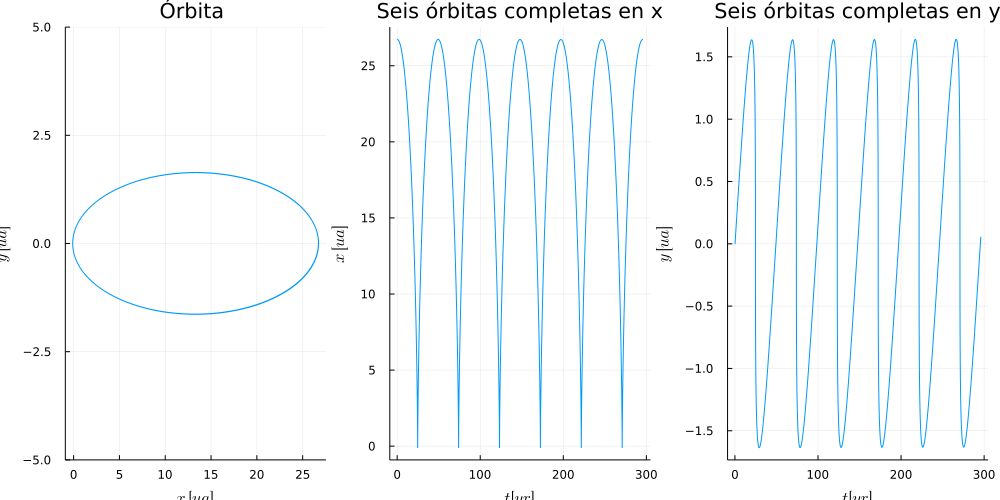

In [13]:
t0 = 0 #Initial time
tf = 250 #Final time 
dt = 0.001 #inital step size value

i_max = 17765 #Maximum number of iterations

Q0 = zeros(4) #position and velocity initial conditions array
Q0[1] = 26.738 # AU -> x0
Q0[2] = 0 #AU  -> y0
Q0[3] = 0 # AU -> vx0
Q0[4] = 0.105 #AU/yr -> vy0

epsilon = 6.68459e-9 #tolerance of 1km -> 6,68459e-9 AU

result, t, DT = RK34_adapt(Comet_EDO, Q0, t0, tf, dt, epsilon, i_max)

N_im = trunc(Int64, Q0[1])+1
DT_im = zeros(N_im+1, length(DT))

for i in 1:N_im+1
    DT_im[i,:] = DT
end

N_array_x = zeros(N_im+1)
N_array_y = LinRange(-2,2,N_im+1)
for i in 1:N_im+1
    N_array_x[i] = i-1
end


p1 = plot(result[1,:], result[2,:], label = false, title = "Órbita ", xlabel = L"x\;[ua]", ylabel = L"y\;[ua]", ylim = (-5,5))
p2 = plot(t, result[1,:], label = false, title="Seis órbitas completas en x", xlabel = L"t[yr]", ylabel = L"x\;[ua]")
p3 = plot(t, result[2,:], label = false, title="Seis órbitas completas en y", xlabel = L"t[yr]", ylabel = L"y\;[ua]")
display(plot(p1, p2, p3, layout=(1,3), size = (1000,500)))

Donde la relación con la posición de la órbita junto con la actualización del paso se muestra en la siguiente gráfica.

In [14]:
p4 = contourf(t, N_array_x,  DT_im, color = :gist_gray, colorbar = false, label = "Tamaño de paso")
p4 = plot!(t, result[1,:], label = false, title="Relación de paso con órbita", xlabel = L"t[yr]", ylabel = L"x\;[ua]", color = :white, xlim = (0,100), ylim = (0, N_im))
p5 = contourf(t, N_array_y,  DT_im, color = :gist_gray, colorbar = false, label = "Tamaño de paso")
p5 = plot!(t, result[2,:], label = false, title="Relación de paso con órbita", xlabel = L"t[yr]", ylabel = L"x\;[ua]", color = :white, xlim = (0,100), ylim = (-2, 2))
display(plot(p4, p5, layout = (1,2), size = (1000, 500)))

Mostrando que el paso se estaba actualizando adecuadamente.

Por último, procedemos a observar el comportamiento de las cantidades conservadas

In [15]:
mom_ang = Lz(result)
energy = E(result)

plot(t, mom_ang, color = :blue, label = "Momentum angular", 
    title = "Cantidades conservadas", xlabel = L"t\;[yr]")
plot!(t, energy, color = :red, label = "Energy")

p_ma = 100*abs((mom_ang[1] - mom_ang[length(mom_ang)])/mom_ang[1])
p_e = 100*abs((energy[1] - energy[length(energy)])/energy[1])

@printf("The porcentual error between the values of initial and final angular momentum  is %0.5e%%.", p_ma)
@printf("\nWhile for energy we have %0.5e%%.", p_e)

The porcentual error between the values of initial and final angular momentum  is 1.95078e-04%.
While for energy we have 7.03726e-02%.

Errores porcentuales los cuales son menores que en el método de Runge-Kutta de orden 4, i.e., en el Runge-Kutta 3/4 con paso adaptativo se conservan mejor el momentum y la energía total.

Es importante revisar también si computacionalmente hablando el paso adaptativo es más eficiente. Entonces encontramos que

In [16]:
function  RK34_adapt_time()
    t0=0;tf=250;dt=0.001;i_max=17765;Q0=zeros(4);Q0[1]=26.738;Q0[2]=0;Q0[3]=0 
    Q0[4]=0.105;epsilon=6.68459e-9;result,t,DT = RK34_adapt(Comet_EDO,Q0,t0,tf,dt,epsilon,i_max)
end
@benchmark  RK34_adapt_time()

BenchmarkTools.Trial: 199 samples with 1 evaluation.
 Range (min … max):  23.042 ms … 30.853 ms  ┊ GC (min … max): 6.69% … 5.63%
 Time  (median):     25.363 ms              ┊ GC (median):    7.86%
 Time  (mean ± σ):   25.232 ms ±  1.336 ms  ┊ GC (mean ± σ):  9.82% ± 3.12%

   ▆     ▄       ▄      ▄█▂█  ▃                                
  ▅█▃▆▆▄▆██▆▇▃▆▃▆█▅▄▄▄█▇█████▅█▅█▆▃▆▁▃▅▅▅▇▃▇▅▁▁▁▁▁▁▄▁▁▁▃▁▁▁▁▃ ▃
  23 ms           Histogram: frequency by time          29 ms <

 Memory estimate: 72.33 MiB, allocs estimate: 1099022.

In [17]:
t0=0;tf=250;N=300000;Q0=zeros(4);Q0[1]=26.738;Q0[2]=0;Q0[3]=0;Q0[4]=0.105;t=LinRange(t0, tf, N)
@benchmark result = RungeKutta4(Q0, t0, tf, N, Comet_EDO)

BenchmarkTools.Trial: 22 samples with 1 evaluation.
 Range (min … max):  197.519 ms … 363.254 ms  ┊ GC (min … max):  7.58% … 45.78%
 Time  (median):     227.216 ms               ┊ GC (median):    11.74%
 Time  (mean ± σ):   229.491 ms ±  32.290 ms  ┊ GC (mean ± σ):  14.17% ±  7.46%

  ▃     ▃ ▃ ▃▃▃█▃                                                
  █▁▇▇▁▁█▇█▁█████▇▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▇ ▁
  198 ms           Histogram: frequency by time          363 ms <

 Memory estimate: 723.26 MiB, allocs estimate: 7799976.

Vemos que runge kutta adaptativo se demora 10 veces menos que Runge Kutta con paso fijo.

# B Orbita Terrestre

Las ecuaciones para el movimeinto de la Tiera alrededor del Sol son

\begin{equation}
    \begin{split}
        &\frac{d^2\vec{r}}{dt^2}=-GM\frac{\vec{r}}{r^3}
    \end{split}
\end{equation}

donde G es la constante gravitacional de Newton y M es la masa del Sol. Como es bien conocido, la órbita terrestre no es perfectamente circular. En el punto de máximo acercamiento al Sol (perihelio), la distancia entre los dos cuerpos es de $1,4710 \times 10^{11}$ m y su velocidad lineal es de $3,0287 \times 10^4$ m/s.

## 1. 

Escriba un programa que calcule la orbita terrestre utilizando uno de los métodos simplécticos con un paso temporal de 1hora. Grafique la trayectoria completando varias vueltas alrededor del Sol.

---

Para hacer la integración se va a utilizar el método de integración PEFRL el cual es simplectico y además de orden 4 en la posición y de orden 3 en la velocidad. Hay una variante de este mismo método que es de orden 4 en la velocidad y orden 3 en la posición. El método está dado por

\begin{equation} \label{PEFRL}
    \begin{split}
        &\vec{r}_1=\vec{r}(t)+\vec{v}(t)\zeta dt,\\
        &\vec{v}_1=\vec{v}(t)+\frac{1}{2m}\vec{F}(\vec{r}_1)(1-2\lambda)dt,\\
        &\vec{r}_2=\vec{r}_1+\vec{v}_1\chi dt,\\
        &\vec{v}_2=\vec{v}_1+\frac{1}{m}\vec{F}(\vec{r}_2)\lambda dt,\\
        &\vec{r}_3=\vec{r}_2+\vec{v}_2(1-2(\chi+\zeta))dt,\\
        &\vec{v}_3=\vec{v}_2+\frac{1}{m}\vec{F}(\vec{r}_3)\lambda dt,\\
        &\vec{r}_4=\vec{r}_3+\vec{v}_3\chi dt,\\
        &\vec{v}(t+dt)=\vec{v}_3+\frac{1}{2m}\vec{F}(\vec{r}_4)(1-2\lambda)dt,\\
        &\vec{r}(t+dt)=\vec{r}_4+\vec{v}(t+dt)\zeta dt,\\ \\
        &\zeta=0.1644986515575760E+00,\\
        &\lambda=-0.2094333910398989E-01,\\
        &\chi=0.1235692651138917E+01.
    \end{split}
\end{equation}

$\vec{v}(t+dt)$ y $\vec{r}(t+dt)$ son la posición y la velocidad en el siguiente paso de tiempo. El artículo con la deducción del método y la demostración de que es simplectico es 

`
Omelyan, I. Mryglod, and R. Folk, Optimized forest–ruth and suzuki-like algorithms for integration of motion in many-body systems, Computer Physics Communications 146, 188 (2002).
`

In [19]:
using StaticArrays
using BenchmarkTools
using LinearAlgebra
using DelimitedFiles
using Plots

mutable struct Molecule
    r::SVector{3,Float64}
    v::SVector{3,Float64}
    f::SVector{3,Float64}
    m::Float64
end

function clear_f(body)
    body.f*=0
end

function move_r(body,dt,cte=1)
    body.r+=body.v*dt*cte
end

function move_v(body,dt,cte=1)
    body.v+=body.f*dt*cte/body.m
end

function calc_f(body)
    clear_f.(body)
    for i in 1:length(body)
        for j in i+1:length(body)
            dr = body[j].r-body[i].r
            d = norm(dr)
            F = -G*body[i].m*body[j].m*dr/d^3
            body[i].f+=-F #3 Newton Law
            body[j].f+=F 
        end
    end
end

function Calc_Energy(data)
    N = trunc(Int,(size(data)[2]-1)/7) #number of particles
    Eₖ=zeros(0)
    Eₚ=zeros(0)
    Et=zeros(0)
    for i in eachrow(data)
        K=0
        P=0
       for j in 1:N
            K+=0.5*i[8+7*(j-1)]*(i[5+7*(j-1)]^2+i[6+7*(j-1)]^2+i[7+7*(j-1)]^2) #cinetic energy
            for jj in j+1:N
                dr=[i[2+7*(jj-1)]-i[2+7*(j-1)],i[3+7*(jj-1)]-i[3+7*(j-1)],i[4+7*(jj-1)]-i[4+7*(j-1)]]
                d = norm(dr)
                P+=-G*i[8+7*(j-1)]*i[8+7*(jj-1)]/d #potential energy
            end
        end
        append!(Eₖ,K)
        append!(Eₚ,P)
        append!(Et,P+K)
    end
    return hcat(data[:,1], Eₖ,Eₚ,Et)
end

function step_PEFRL(body,dt)
    const1 = 0.1644986515575760     #ζ
    const3 = 0.1235692651138917e1   #χ
    const4 = -0.2094333910398989e-1 #λ
    const2 = (1-2*const4)/2         #(1-2λ)/2
    const5 = 1-2*(const3+const1)    #1-2*(ζ+χ)
    move_r.(body,dt,const1)
    calc_f(body)
    move_v.(body,dt,const2)
    move_r.(body,dt,const3)
    calc_f(body)
    move_v.(body,dt,const4)
    move_r.(body,dt,const5)
    calc_f(body)
    move_v.(body,dt,const4)
    move_r.(body,dt,const3)
    calc_f(body)
    move_v.(body,dt,const2)
    move_r.(body,dt,const1)
end

function Propagate(data,tf,dt,vis_steps=10000,file="data.csv")
    N=trunc(Int, tf/dt) #number of steps
    t=0
    Save_step(t,data,file,true) #save initial condition

    for i in 1:N
        step_PEFRL(data,dt) #temporal integration
        t+=dt
        
        if i%vis_steps==0 #save data every vis_steps
            Save_step(t,data,file)
        end
    end
end

function Save_step(t,data,file,start=false)
    y = [t]
    for i in data
        y=vcat(y,i.r,i.v,i.m) #concatenate data in 1 array
    end
    
    if start
        f = open(file, "w")   #create or overwritte the file
        write(f, join(y,",")*"\n")
        close(f)
    else
        f = open(file, "a")  #append to the file
        write(f, join(y,",")*"\n")
        close(f)
    end
end

Save_step (generic function with 2 methods)

Voy a hablar un poco del diseño del programa. El struct Molecule representa cada cuerpo de la simulación. De esta manera la evolución temporal se puede hacer de manera más organizada. Para la posición, velocidad y fuerza se utilizan StaticArrays. Estos Arrays tienen tamaño fijo, pero son los más rápidos que hay. Además las operaciones entre ellos están vectorizadas. Como los vectores velocidad, posición y fuerza siempre tienen 3 componentes estos arrays son ideales para estas cantidades. 

Luego se definen los métodos necesarios para actualizar cada cuerpo. La definición de la mayoría de ellos está hecha para actualizar un solo elemento, sin embargo, cuando una función de estas recibe un array y se le coloca un punto, por ejemplo `move_v.(body,dt,const2)`, la operación de actualización se realiza elementwise de forma vectorizada, obteneiendo una gran reducción en overhead de la operación. Por último, se separa la función que hace la evolución temporal de la que hace el paso de tiempo para que cambiar el algoritmo de integración se reduzca simplemente a crear otra función paso y reemplazar el nombre dentro de la propagación. Aprovechando este mismo comportamiento vectorial, se pueden inicializar todas las partículas a la vez como se puede ver a continuación. 

In [20]:
r1 = @SVector [0, 0, 0] 
r2 = @SVector [1 , 0, 0]   #AU
v1 = @SVector [0, 0, 0] 
v2 = @SVector [0, 365*24*3600*29780.0/1.49598261e11 , 0] #AU/year
m1 = 1
m2 = 5.97219e24/1.98855e30  #solar mases
G=4*pi^2 #AU^3 Solar_mass^-1 year^-2
data=Molecule.([r1,r2],[v1,v2],[r1,r1],[m1,m2]) #initialize 2 particles at the same time
clear_f.(data)


dt=0.0005     #0.0005 years -> 4.5 hours 
t=5           #5 years
vis_steps=5
file="data.csv"

println("Execution time for the first time with $(trunc(Int, t/dt)) time steps")
@time Propagate(data,t,dt,vis_steps,file)

Execution time for the first time with 10000 time steps
  0.341840 seconds (2.88 M allocations: 163.392 MiB, 4.16% gc time, 83.76% compilation time)


In [21]:
@benchmark Propagate(data,t,dt,vis_steps,file)

BenchmarkTools.Trial: 103 samples with 1 evaluation.
 Range (min … max):  43.037 ms … 55.773 ms  ┊ GC (min … max): 0.00% … 3.14%
 Time  (median):     48.819 ms              ┊ GC (median):    3.53%
 Time  (mean ± σ):   48.806 ms ±  2.835 ms  ┊ GC (mean ± σ):  2.27% ± 1.72%

             ▆▃▁     ▁  ▁▁█ ▁▃▃▃▁ █▁  ▃      ▁                 
  ▇▇▄▄▁▁▁▁▄▁▇███▄▇▁▄▁█▇▇███▇█████▇██▇▇█▄▄▄▄▁▇█▄▄▄▁▁▁▁▄▄▇▁▇▁▁▄ ▄
  43 ms           Histogram: frequency by time        55.4 ms <

 Memory estimate: 31.34 MiB, allocs estimate: 284086.

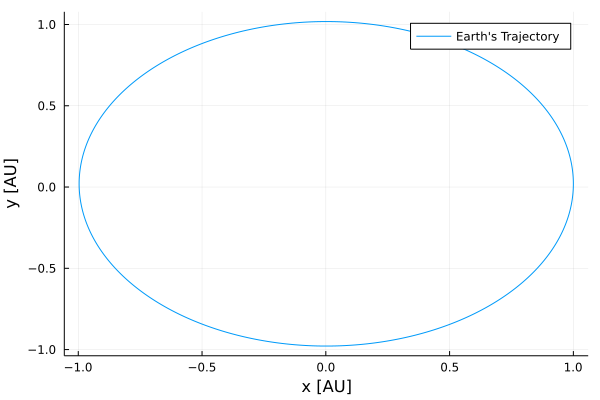

In [22]:
data=readdlm(file, ',')
plot(data[:,9],data[:,10],label="Earth's Trajectory")
xlabel!("x [AU]")
ylabel!("y [AU]")

## 2.
Incluya en el programa una función que calcule la energía potencial, la energía cinética y la energía total del sistema en cada paso y grafique sus resultados en los mismos ejes. Los resultados deben mostrar que las energías cinética y potencial cambian visiblemente a lo largo de la trayectoria mientras que la energía total debe permanecer aproximadamente constante.

----

El programa guarda toda la información en un archivo y solo tiene en memoria la información de cada partícula. Es decir, tiene complejidad espacial O(N), entonces hay que leer la información del archivo y pasarsela a la función que va a calcular la energía en cada paso de tiempo guardado. 

The total Energy difference is  ΔE=4.5300711492993673e-14 %.
The total Angular momentum difference is  ΔLz=0.0002723661888390785 %.


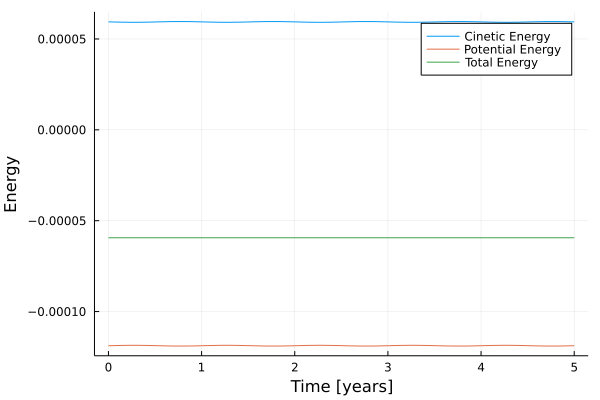

In [23]:
Energy=Calc_Energy(data)

println("The total Energy difference is  ΔE=$(abs((Energy[1,4]-Energy[size(Energy)[1],4])/Energy[1,4])) %.")
a=size(Energy)[1]
L0=cross([data[1,9],data[1,10],data[1,11]],[data[1,12],data[1,13],data[1,14]])
Lf=cross([data[a,9],data[a,10],data[a,11]], [data[a,12],data[a,13],data[a,14]])
println("The total Angular momentum difference is  ΔLz=$(abs((L0[3]-Lf[3])/L0[3])) %.")

plot(Energy[:,1],Energy[:,2],label="Cinetic Energy")
plot!(Energy[:,1],Energy[:,3],label="Potential Energy")
plot!(Energy[:,1],Energy[:,4],label="Total Energy")
xlabel!("Time [years]")
ylabel!("Energy")

## 3.
Ahora grafique únicamente la energía total para comprobar que existe una pequeña variación en cada una de las orbitas. Sin embargo, el método simpléctico debe retornar al valor inicial después de cada vuelta.

----

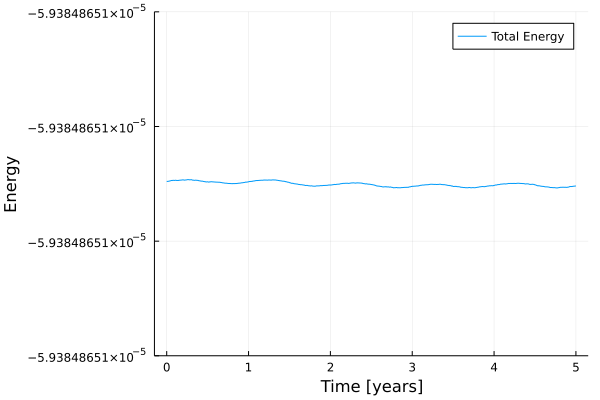

GKS: Possible loss of precision in routine SET_WINDOW


In [24]:
plot(Energy[:,1],Energy[:,4],label="Total Energy")
xlabel!("Time [years]")
ylabel!("Energy")

La variación en energía es tan pequeña que el programa tiene problemas para graficar la energía.

## 4.
Utilice el programa que escribió para verificar si puede describir el movimiento del planeta enano Plutón. Este objeto tiene una orbita mucho mas excentrica que la orbita terrestre, con una distancia al Sol en el perihelio de $4.4368 \times 10^{12}$ m y una velocidad lineal en este punto de $6.1218 \times 10^3$ m/s.

Execution time with 1000000 time steps
  0.460411 seconds (13.04 M allocations: 1.360 GiB, 17.01% gc time)


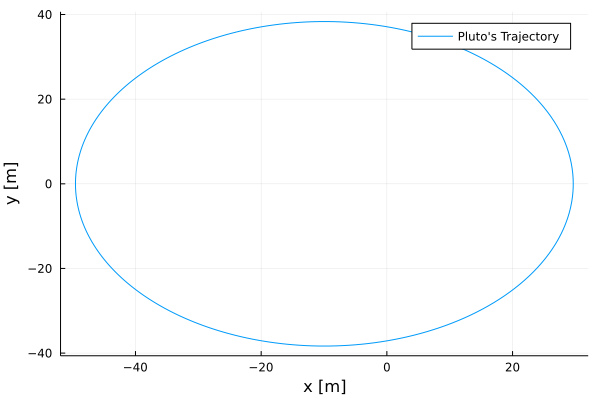

In [25]:
r1 = @SVector [0, 0, 0] 
r2 = @SVector [4.4368e12/1.49598261e11 , 0, 0]   #AU
v1 = @SVector [0, 0, 0] 
v2 = @SVector [0, 365*24*3600*6.1218e3/1.49598261e11, 0] #AU/year
m1 = 1
m2 = 1.25e22/1.98855e30 #solar mases
G=4*pi^2 #AU^3 Solar_mass^-1 year^-2

data=Molecule.([r1,r2],[v1,v2],[r1,r1],[m1,m2]) #initialize 2 particles at the same time
clear_f.(data)

dt=0.0005           #0.0005 years -> 4.5 hours
t=500               #500 years
vis_steps=2000
file="data.csv"

println("Execution time with $(trunc(Int, t/dt)) time steps")
@time Propagate(data,t,dt,vis_steps,file)

data=readdlm(file, ',')
plot(data[:,9],data[:,10],label="Pluto's Trajectory")
xlabel!("x [m]")
ylabel!("y [m]")

The total Energy difference is  ΔE=1.5445040932105986e-13 %
The total Angular momentum difference is  ΔLz=7.274000435319775e-9 %.


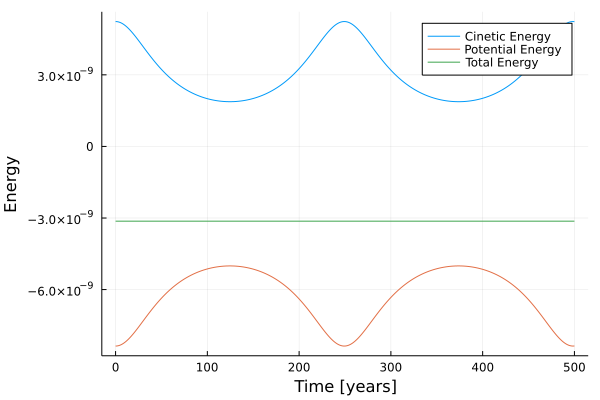

In [26]:
Energy=Calc_Energy(data)

println("The total Energy difference is  ΔE=$(abs((Energy[1,4]-Energy[size(Energy)[1],4])/Energy[1,4])) %")
a=size(Energy)[1]
L0=cross([data[1,9],data[1,10],data[1,11]],[data[1,12],data[1,13],data[1,14]])
Lf=cross([data[a,9],data[a,10],data[a,11]], [data[a,12],data[a,13],data[a,14]])
println("The total Angular momentum difference is  ΔLz=$(abs((L0[3]-Lf[3])/L0[3])) %.")

plot(Energy[:,1],Energy[:,2],label="Cinetic Energy")
plot!(Energy[:,1],Energy[:,3],label="Potential Energy")
plot!(Energy[:,1],Energy[:,4],label="Total Energy")
xlabel!("Time [years]")
ylabel!("Energy")

# C. Problema Gravitacional de los N-Cuerpos

Las ecuaciones de movimiento de N-partículas moviendose bajo su interacción gravitacional mutua se pueden escribir en la forma
\begin{equation}
    m_i\ddot{x}_i=-Gm_i\sum^N_{j=1,\;i\neq j}\frac{m_j}{|x_{ij}|^2}\hat{x}_{ij},
\end{equation}

donde $x_{ij} = x_i - x_j$ es el vector que apunta desde la partícula j a la partícula i.

## 1. 

Implemente un programa que resuelva el problema diferencial de las ecuaciónes de movimiento utilizando un método simplectico de orden 4. El algoritmo debe ser lo suficientemente general para poder incluír un número arbitrario de partículas y las condiciones iniciales deben ser leídas de un archivo.

---

El algoritmo del punto anteriror es lo suficientemente general como para hacer la propagación de N moléculas. Sin embargo, todavía falta hacer una función que lea de un archivo las condiciones iniciales e inicialize el sistema. Entonces:



In [27]:
function start_from_file(file)
    data=readdlm(file, comments=true)
    r = Array{Float64}[]
    v = Array{Float64}[]
    m = []
    for i in eachrow(data)
        push!(r,[i[1],i[2],i[3]])
        push!(v,[i[4],i[5],i[6]])
        append!(m,[i[7]])
    end
    
    sys = Molecule.(r,v,r,m)
    clear_f.(sys)
    return sys
end

sys = start_from_file("sun_earth.dat")

2-element Vector{Molecule}:
 Molecule([0.0, 0.0, 0.0], [0.0, 0.0, 0.0], [0.0, 0.0, 0.0], 1.98855e30)
 Molecule([1.49598261e11, 0.0, 0.0], [0.0, 29780.0, 0.0], [0.0, 0.0, 0.0], 5.97219e24)

## 2. 

Con el fin de probar el código implementado, utilice los datos iniciales para el sistema SolTierra dados en el archivo sun_earth.dat y grafique el comportamiento del sistema a lo largo de algunos años. Comprube que la orbita no se comporta a la forma de una espiral.

---

Las funciones diseñadas en el punto anterior ya son generales. Sin embargo hay un detalle. El archivo puede tener datos en unidades distintas a las deseadas en el programa. Es por esto que se hace una función para hacer la conversión de unidades de los datos leidos.

In [28]:
function convert_units(data, Rconv, Tconv, Mconv)
    for i in eachindex(data)
        data[i].r*=Rconv
        data[i].v*=Rconv/Tconv
        data[i].m*=Mconv
    end
end

G=4*pi^2 #AU^3 Solar_mass^-1 year^-2
dt=0.0005     #0.0005 years -> 4.5 hours 
t=5           #5 years
vis_steps=5
file="data.csv"
convert_units(sys, 1/1.49598261e11, 1/(365*24*3600), 1/1.98855e30) #Units on the file where on SI units
sys

2-element Vector{Molecule}:
 Molecule([0.0, 0.0, 0.0], [0.0, 0.0, 0.0], [0.0, 0.0, 0.0], 1.0)
 Molecule([1.0, 0.0, 0.0], [0.0, 6.277760675306246, 0.0], [0.0, 0.0, 0.0], 3.0032888285434113e-6)

Execution time with 10000 time steps
  0.053037 seconds (284.08 k allocations: 31.339 MiB)


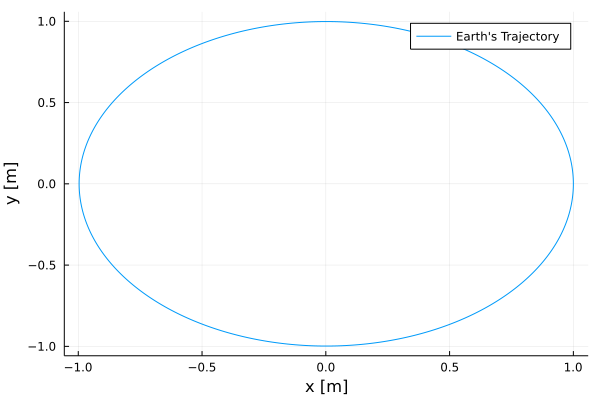

In [29]:
println("Execution time with $(trunc(Int, t/dt)) time steps")
@time Propagate(sys,t,dt,vis_steps,file)

data=readdlm(file, ',')
plot(data[:,9],data[:,10],label="Earth's Trajectory")
xlabel!("x [m]")
ylabel!("y [m]")

## 3.

Con el fin de asegurar la convergencia del algoritmo, implmente una rutina dentro del programa que calcule la energía total del sistema de N-partículas. Evalue el comportamiento de la energía a lo largo de la evolución y grafique para comprobar si existe algun cambio significativo. El comportamiento mejora o empeora al modificar el paso de la integración?

---

Es la misma funcion del ejercicio anterior. Esta ya está generalizada para N cuerpos. Antes con un $dt=0.0005$ la diferencia de energías era de $\Delta E=1.5445040932105986\times 10^{-13}$ %. Un dt más pequeño en general debería mejorar esto, sin embargo, un dt demasiado pequeño abre la puerta para inestabilidades numéricas.

In [30]:
dt=0.0005*100     
t=5           #5 years
sys = start_from_file("sun_earth.dat")
convert_units(sys, 1/1.49598261e11, 1/(365*24*3600), 1/1.98855e30)
Propagate(sys,t,dt,vis_steps,file)
data=readdlm(file, ',')
Energy=Calc_Energy(data)
println("The total Energy difference is  ΔE=$(abs((Energy[1,4]-Energy[size(Energy)[1],4])/Energy[1,4])) % with dt=$dt years.")

dt=0.0005*10
sys = start_from_file("sun_earth.dat")
convert_units(sys, 1/1.49598261e11, 1/(365*24*3600), 1/1.98855e30)
Propagate(sys,t,dt,vis_steps,file)
data=readdlm(file, ',')
Energy=Calc_Energy(data)
println("The total Energy difference is  ΔE=$(abs((Energy[1,4]-Energy[size(Energy)[1],4])/Energy[1,4])) % with dt=$dt years.")

dt=0.0005
sys = start_from_file("sun_earth.dat")
convert_units(sys, 1/1.49598261e11, 1/(365*24*3600), 1/1.98855e30)
Propagate(sys,t,dt,vis_steps,file)
data=readdlm(file, ',')
Energy=Calc_Energy(data)
println("The total Energy difference is  ΔE=$(abs((Energy[1,4]-Energy[size(Energy)[1],4])/Energy[1,4])) % with dt=$dt years.")

dt=0.0005/2
sys = start_from_file("sun_earth.dat")
convert_units(sys, 1/1.49598261e11, 1/(365*24*3600), 1/1.98855e30)
Propagate(sys,t,dt,vis_steps,file)
data=readdlm(file, ',')
Energy=Calc_Energy(data)
println("The total Energy difference is  ΔE=$(abs((Energy[1,4]-Energy[size(Energy)[1],4])/Energy[1,4])) % with dt=$dt years.")

dt=0.0005/10
sys = start_from_file("sun_earth.dat")
convert_units(sys, 1/1.49598261e11, 1/(365*24*3600), 1/1.98855e30) 
Propagate(sys,t,dt,vis_steps,file)
data=readdlm(file, ',')
Energy=Calc_Energy(data)
println("The total Energy difference is  ΔE=$(abs((Energy[1,4]-Energy[size(Energy)[1],4])/Energy[1,4])) % with dt=$dt years.")

dt=0.0005/100
sys = start_from_file("sun_earth.dat")
convert_units(sys, 1/1.49598261e11, 1/(365*24*3600), 1/1.98855e30)
Propagate(sys,t,dt,vis_steps,file)
data=readdlm(file, ',')
Energy=Calc_Energy(data)
println("The total Energy difference is  ΔE=$(abs((Energy[1,4]-Energy[size(Energy)[1],4])/Energy[1,4])) % with dt=$dt years.")

The total Energy difference is  ΔE=6.039630980362076e-9 % with dt=0.05 years.
The total Energy difference is  ΔE=6.184631140858107e-13 % with dt=0.005 years.
The total Energy difference is  ΔE=7.827780373853619e-14 % with dt=0.0005 years.
The total Energy difference is  ΔE=2.396259298118455e-15 % with dt=0.00025 years.
The total Energy difference is  ΔE=8.615122714663968e-14 % with dt=5.0e-5 years.
The total Energy difference is  ΔE=1.9466754107571828e-13 % with dt=5.0e-6 years.


## 4. 

Ahora utilice su código para estudiar la evolución del sistema de 13 estrellas S0 moviendose alrededor del agujero negro supermasivo SgrA*, proporcionado en el archivo S0stars.dat. Verifique también el comportamiento de la energía del sistema de 13+1 partículas. Grafique las orbitas de estas estrellas a lo largo de un periodo de al menos 100 años.

---

readdlm tiene un problema con los delimitadores, si el archivo tiene espacios iniciales crashea. https://github.com/JuliaLang/julia/issues/44846. Aún así hay un workarround y se pueden cargar los datos sin problemas. La función `start_from_file` ya tiene implementado el workarround.

Execution time with 100000 time steps
  0.792757 seconds (1.36 M allocations: 562.450 MiB, 29.59% gc time)


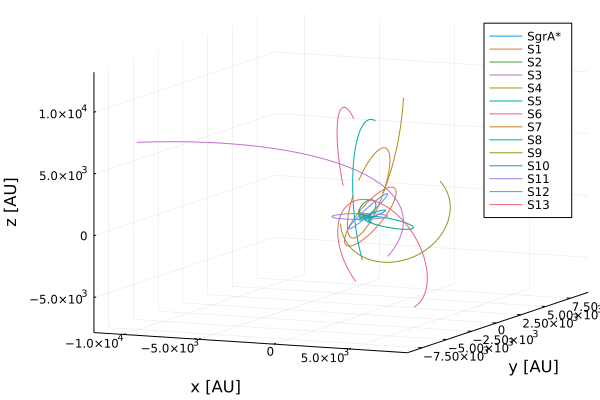

In [29]:
sys = start_from_file("S0stars.dat")  
convert_units(sys, 8000, 1, 1) #Units on the file where on arcseconds, years and solar masses

G=4*pi^2      #AU^3 Solar_mass^-1 year^-2
dt=0.001      #0.001 years -> 9 hours 
t=100         #100 years
vis_steps=1000
file="data.csv"

println("Execution time with $(trunc(Int, t/dt)) time steps")
@time Propagate(sys,t,dt,vis_steps,file)

data=readdlm(file, ',')
N = length(sys)

plot(data[:,2], data[:,3], data[:,4], label="SgrA*", zlabel="z [AU]")

for i in 2:N
    plot!(data[:,2+7*(i-1)],data[:,3+7*(i-1)], data[:,4+7*(i-1)],label="S"*string(i-1))
end
xlabel!("x [AU]")
ylabel!("y [AU]")

También se puede hacer una animación del movimiento de las estrellas. Puede descargar el Gif del repositorio.

┌ Info: Saved animation to 
│   fn = /home/juanessao2000/Documents/1-PRINCIPAL-2022-1/1-UNIVERSIDAD/1- FÍSICA/3-NOVENO_SEMESTRE/COMPUTATIONAL_ASTROPHYSICS/ejercicios03-agudelo_del_valle/tmp.gif
└ @ Plots /home/juanessao2000/.julia/packages/Plots/AJMX6/src/animation.jl:114


Plots.AnimatedGif("/home/juanessao2000/Documents/1-PRINCIPAL-2022-1/1-UNIVERSIDAD/1- FÍSICA/3-NOVENO_SEMESTRE/COMPUTATIONAL_ASTROPHYSICS/ejercicios03-agudelo_del_valle/tmp.gif")
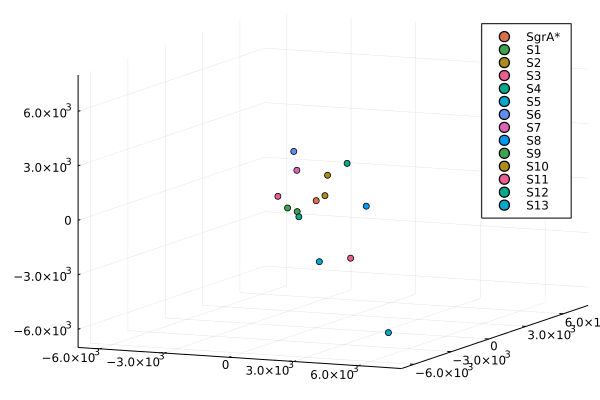

In [30]:
trail=30
@gif for j in 1:size(data)[1]
    if j<trail+1
        e=1
    else
        e=j-trail
    end
    plot(data[e:j,2],data[e:j,3], data[e:j,4], lims = (-7e3, 8e3), label = "")
    scatter3d!((data[j,2],data[j,3], data[j,4]), label="SgrA*")
    for i in 2:N
        scatter3d!((data[j,2+7*(i-1)],data[j,3+7*(i-1)], data[j,4+7*(i-1)]), label="S"*string(i-1))
        plot!(data[e:j,2+7*(i-1)],data[e:j,3+7*(i-1)], data[e:j,4+7*(i-1)], label = "")
    end
end

## 5.

Modifique el código para incorporar el método de Verlet para solucionar el problema y resuelva de nuevo para el sistema de las 13 estrellas S0 moviendose alrededor de SgrA*. Mejora el tiempo de computo utilizando este método? Se conserva la energía total del sistema?

----

Desde el principio se utilizó el método PEFRL que es un método más elaborado que Verlet, sin embargo, involucra muchas más operaciones, Utilizando Verlet y comparando con PEFRL vemos que cambia.

La energía del sistema de 13 estrellas con PEFRL es 

Execution time with 100000 time steps
  0.667107 seconds (1.36 M allocations: 562.485 MiB, 17.98% gc time)
The total Energy difference is  ΔE=3.032619133591652e-8 with dt=0.001 years.


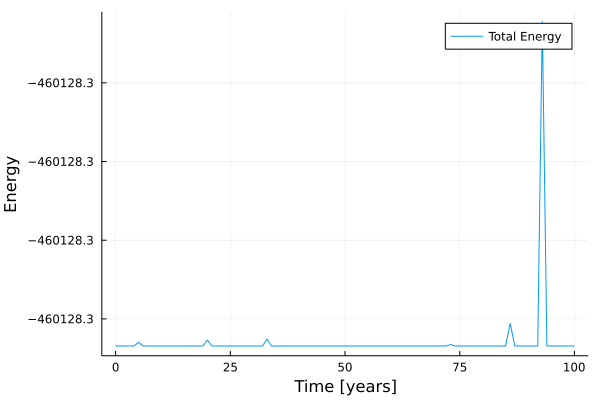

In [31]:
sys = start_from_file("S0stars.dat")  
convert_units(sys, 8000, 1, 1)
println("Execution time with $(trunc(Int, t/dt)) time steps")
@time Propagate(sys,t,dt,vis_steps,file)
data=readdlm(file, ',')
Energy=Calc_Energy(data)
println("The total Energy difference is  ΔE=$(abs(Energy[1,4]-Energy[size(Energy)[1],4])) with dt=$dt years.")
plot(Energy[:,1],Energy[:,4],label="Total Energy")
xlabel!("Time [years]")
ylabel!("Energy")

Utilizando los mismos parámetros pero con position Verlet tenemos que

In [32]:
function Propagate_VerletP(data,tf,dt,vis_steps=10000,file="data.csv")
    N=trunc(Int, tf/dt) #number of steps
    t=0
    Save_step(t,data,file,true) #save initial condition
    for i in 1:N
        move_r.(data,dt,0.5)  #Position Verlet
        calc_f(data)
        move_v.(data,dt,1)
        move_r.(data,dt,0.5)
        t+=dt
        if i%vis_steps==0 #save data every vis_steps
            Save_step(t,data,file)
        end
    end
end
sys = start_from_file("S0stars.dat")  
convert_units(sys, 8000, 1, 1)
println("Execution time with $(trunc(Int, t/dt)) time steps")
@time Propagate_VerletP(sys,t,dt,vis_steps,file)
data=readdlm(file, ',')
Energy=Calc_Energy(data)
println("The total Energy difference is  ΔE=$(abs(Energy[1,4]-Energy[size(Energy)[1],4])) with dt=$dt years.")

Execution time with 100000 time steps
  0.328859 seconds (916.41 k allocations: 200.350 MiB, 15.40% gc time)
The total Energy difference is  ΔE=0.018663277907762676 with dt=0.001 years.


Veamos ahora como se comporta velocity Verlet

In [33]:
function Propagate_VerletV(data,tf,dt,vis_steps=10000,file="data.csv")
    N=trunc(Int, tf/dt) #number of steps
    t=0
    Save_step(t,data,file,true) #save initial condition
    for i in 1:N
        calc_f(data)
        move_v.(data,dt,0.5)  #Velocity Verlet
        move_r.(data,dt,1)
        calc_f(data)
        move_v.(data,dt,0.5)
        t+=dt
        if i%vis_steps==0 #save data every vis_steps
            Save_step(t,data,file)
        end
    end
end
sys = start_from_file("S0stars.dat")  
convert_units(sys, 8000, 1, 1)
println("Execution time with $(trunc(Int, t/dt)) time steps")
@time Propagate_VerletV(sys,t,dt,vis_steps,file)
data=readdlm(file, ',')
Energy=Calc_Energy(data)
println("The total Energy difference is  ΔE=$(abs(Energy[1,4]-Energy[size(Energy)[1],4])) with dt=$dt years.")

Execution time with 100000 time steps
  0.394339 seconds (982.07 k allocations: 241.272 MiB, 11.48% gc time)
The total Energy difference is  ΔE=0.03858155483612791 with dt=0.001 years.


Vemos que así se gane en un poco en tiempo de ejecución (que no es mucho), para obtener buenos resultados es necesario disminuir el dt de los métodos Verlet, por lo tanto, la mejora en tiempo de ejecución se pierde debido a que toca hacer más pasos de tiempo para obtener el mismo resultado.

| Integration method | Execution time | Energy diference |
| :- | -: | :-: |
| Position Verlet | 0.173431 s | 0.06 %
| Velocity Verlet | 0.228064 s | 0.005 %
| PEFRL | 0.298807 s | 3e-8 %

Los tiempos de ejecución puenden ser algo engañosos a primera vista porque incluyen el tiempo de compilación. Para ver únicamente el tiempo de ejecución hacemos un @benchmark

In [34]:
println("Position Verlet")
sys = start_from_file("S0stars.dat")  
convert_units(sys, 8000, 1, 1)
@benchmark Propagate_VerletP(sys,t,dt,vis_steps,file)

Position Verlet


BenchmarkTools.Trial: 41 samples with 1 evaluation.
 Range (min … max):  117.124 ms … 169.743 ms  ┊ GC (min … max): 10.70% … 8.14%
 Time  (median):     119.784 ms               ┊ GC (median):    11.13%
 Time  (mean ± σ):   123.130 ms ±  11.146 ms  ┊ GC (mean ± σ):  10.97% ± 1.17%

  █ ▃▅                                                           
  █▇███▅▅▄▅▄▁▁▄▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▄▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▄▁▁▁▄ ▁
  117 ms           Histogram: frequency by time          170 ms <

 Memory estimate: 177.93 MiB, allocs estimate: 461004.

In [35]:
println("Velocity Verlet")
sys = start_from_file("S0stars.dat")  
convert_units(sys, 8000, 1, 1)
@benchmark Propagate_VerletV(sys,t,dt,vis_steps,file)

Velocity Verlet


BenchmarkTools.Trial: 27 samples with 1 evaluation.
 Range (min … max):  179.369 ms … 203.527 ms  ┊ GC (min … max): 7.17% … 6.44%
 Time  (median):     188.074 ms               ┊ GC (median):    9.33%
 Time  (mean ± σ):   188.766 ms ±   4.999 ms  ┊ GC (mean ± σ):  9.06% ± 0.91%

          ▁        ▁  █▄▁▄ ▁                                     
  ▆▁▁▁▁▁▁▁█▁▁▁▁▁▆▁▁█▁▆████▁█▆▁▆▁▆▁▁▁▁▁▆▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▆▁▆ ▁
  179 ms           Histogram: frequency by time          204 ms <

 Memory estimate: 220.66 MiB, allocs estimate: 561004.

In [36]:
println("PEFRL")
sys = start_from_file("S0stars.dat")  
convert_units(sys, 8000, 1, 1)
@benchmark Propagate(sys,t,dt,vis_steps,file)

PEFRL


BenchmarkTools.Trial: 12 samples with 1 evaluation.
 Range (min … max):  407.520 ms … 480.583 ms  ┊ GC (min … max):  9.79% … 9.60%
 Time  (median):     411.401 ms               ┊ GC (median):    10.57%
 Time  (mean ± σ):   423.900 ms ±  26.292 ms  ┊ GC (mean ± σ):  10.25% ± 0.57%

  ███▁ █               ▁                                   ▁  ▁  
  ████▁█▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁█▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁█▁▁█ ▁
  408 ms           Histogram: frequency by time          481 ms <

 Memory estimate: 562.46 MiB, allocs estimate: 1361004.

Vemos que realmente no se gana mucho en el tiempo de ejecución pero Verlet pierde mucho en presición.

### REFERENCES
[1] Larrañaga, E. Jupyter-notebooks. Astrofísica Computacional.
